# Rock Daisy Visualization Notebook

This notebook includes various visualizations of rock daisies throughout the Americas. 

# 1. Imports

In [2]:
import sys
import os

# Add the parent directory of 'rockdaisy' to the Python path
sys.path.append(os.path.abspath(".."))

In [3]:
import rockdaisy

In [4]:
import numpy as np
import pandas as pd
from rockdaisy.nomenclator import Nomenclator
from rockdaisy.plotting import plot_geographical_positions, plot_geographical_heatmap_overlay, plot_3d_relief_with_species

import pyvista as pv
import ipywidgets
import trame
pv.set_jupyter_backend('trame')  # <-- Important line

# 2. Nomenclator

In [5]:
nomenclator_filepath = '../data/nomenclator.txt'
nomenclator = Nomenclator(nomenclator_filepath)

In [6]:
nomenclator.grouped_by_accepted()

{'Perityle tenuifolius': {'authors': '(Phil.) I.H. Lichter-Marck',
  'synonyms': [{'scientific_name': 'Perityle toumeyi',
    'genus': 'Perityle',
    'species': 'toumeyi',
    'authors': '(B.L. Rob. & Greenm.) J.F. Macbr.',
    'accepted_name': 'Perityle tenuifolius',
    'accepted_authors': '(Phil.) I.H. Lichter-Marck',
    'relationship': 'synonym'},
   {'scientific_name': 'Lycapsus tenuifolius',
    'genus': 'Lycapsus',
    'species': 'tenuifolius',
    'authors': 'Phil.',
    'accepted_name': 'Perityle tenuifolius',
    'accepted_authors': '(Phil.) I.H. Lichter-Marck',
    'relationship': 'synonym'}]},
 'Perityle brandegeeana': {'authors': 'Rose', 'synonyms': []},
 'Perityle carterae': {'authors': '(A.M. Powell) I.H. Lichter-Marck',
  'synonyms': []},
 'Perityle rotundifolia': {'authors': '(Benth.) T.S. Brandegee',
  'synonyms': [{'scientific_name': 'Laphamia peninsularis',
    'genus': 'Laphamia',
    'species': 'peninsularis',
    'authors': 'Greene',
    'accepted_name': 'Perit

In [7]:
names_to_accepted_d = nomenclator.names_with_accepted()

accepted_w_synonyms_d = nomenclator.accepted_with_synonyms()

In [8]:
rock_daisy_df = nomenclator.to_dataframe()

accepted_df = rock_daisy_df[rock_daisy_df['relationship'] == 'accepted']

In [9]:
accepted_df

,name,scientific_name,genus,species,authors,accepted_name,accepted_authors,relationship
1,Perityle tenuifolius,Perityle tenuifolius,Perityle,tenuifolius,(Phil.) I.H. Lichter-Marck,Perityle tenuifolius,(Phil.) I.H. Lichter-Marck,accepted
3,Perityle brandegeeana,Perityle brandegeeana,Perityle,brandegeeana,Rose,Perityle brandegeeana,Rose,accepted
5,Perityle carterae,Perityle carterae,Perityle,carterae,(A.M. Powell) I.H. Lichter-Marck,Perityle carterae,(A.M. Powell) I.H. Lichter-Marck,accepted
7,Perityle rotundifolia,Perityle rotundifolia,Perityle,rotundifolia,(Benth.) T.S. Brandegee,Perityle rotundifolia,(Benth.) T.S. Brandegee,accepted
9,Galeana pratensis,Galeana pratensis,Galeana,pratensis,(Kunth) Rydb.,Galeana pratensis,(Kunth) Rydb.,accepted
...,...,...,...,...,...,...,...,...
217,Perityle socorrosensis,Perityle socorrosensis,Perityle,socorrosensis,Rose,Perityle socorrosensis,Rose,accepted
218,Perityle trichodonta,Perityle trichodonta,Perityle,trichodonta,S.F. Blake,Perityle trichodonta,S.F. Blake,accepted
223,Villanova oppositifolia,Villanova oppositifolia,Villanova,oppositifolia,Lag.,Villanova oppositifolia,Lag.,accepted
225,Villanova titicacaensis,Villanova titicacaensis,Villanova,titicacaensis,(Meyen & Walp.) Walp.,Villanova titicacaensis,(Meyen & Walp.) Walp.,accepted


In [10]:
accepted_df.genus.unique()

array(['Perityle', 'Galeana', 'Galinsogeopsis', 'Eutetras', 'Laphamia',
       'Villanova', 'Nesothamnus', 'Pericome', 'Lichter'], dtype=object)

###  List of Rock Daisy Genera 
- Perityle
- Galinsogeopsis
- Pericome
- eutetras
- Nesothamnus
- Laphamia
- Galeana
- Villanova

# 3. Rock Daisy Collections Data

In [11]:
api_key = '9c4fff68-2c4d-4d2c-acee-e27624fbc741'

In [12]:
df_full = pd.read_csv('../data/gbif/gbif_occurrences.csv')

/var/folders/qx/bpj16cl90cq20swjd4j79cdh0000gn/T/ipykernel_48649/3406933072.py:1: DtypeWarning: Columns (83,125,136,141,142,145,147,148,151,153,154,156,157,158,161,164,165,166,167,168,171,172,174,175,177,178,179,181,182,183) have mixed types. Specify dtype option on import or set low_memory=False.
  df_full = pd.read_csv('../data/gbif/gbif_occurrences.csv')


In [13]:
df_full

,key,datasetKey,publishingOrgKey,installationKey,hostingOrganizationKey,publishingCountry,protocol,lastCrawled,lastParsed,crawlId,...,organismName,verbatimIdentification,organismQuantity,organismQuantityType,waterBody,island,coordinatePrecision,samplingEffort,parentEventID,acceptedNameUsageID
0,3764504470,50c9509d-22c7-4a22-a47d-8c48425ef4a7,28eb1a3f-1c15-4a95-931a-4af90ecb574d,997448a8-f762-11e1-a439-00145eb45e9a,28eb1a3f-1c15-4a95-931a-4af90ecb574d,CL,DWC_ARCHIVE,2025-05-08T21:36:07.572+00:00,2025-05-12T14:28:36.026+00:00,542,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,3455569773,50c9509d-22c7-4a22-a47d-8c48425ef4a7,28eb1a3f-1c15-4a95-931a-4af90ecb574d,997448a8-f762-11e1-a439-00145eb45e9a,28eb1a3f-1c15-4a95-931a-4af90ecb574d,CL,DWC_ARCHIVE,2025-05-08T21:36:07.572+00:00,2025-05-12T12:05:49.961+00:00,542,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1456004768,821cc27a-e3bb-4bc5-ac34-89ada245069d,bc092ff0-02e4-11dc-991f-b8a03c50a862,b2ff19b5-d74f-40d2-82f1-ec5db01e8e31,bc092ff0-02e4-11dc-991f-b8a03c50a862,US,EML,2025-05-02T11:18:50.636+00:00,2025-05-02T13:21:15.208+00:00,448,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3125266488,9b7d1acf-b22f-4a1f-b6e8-f1ddd744dc07,8a471700-4ce8-11db-b80e-b8a03c50a862,cb27a4ab-3360-4cf5-b5de-48a06a9c47ae,96710dc8-fecb-440d-ae3e-c34ae8a9616f,US,DWC_ARCHIVE,2025-05-09T15:48:15.665+00:00,2025-05-09T16:01:03.401+00:00,307,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1096722507,0943f690-fde5-11dd-83f4-b8a03c50a862,6ba9a8cc-513a-4a51-bf93-6f5de8040a96,4346b227-ca68-4d54-8a77-909148492e0b,4c415e40-1e21-11de-9e40-a0d6ecebb8bf,SE,EML,2025-01-21T14:10:51.862+00:00,2025-02-06T17:56:31.809+00:00,323,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8719,2629576867,98c51784-da02-4f0e-81a4-f3635cb3cba7,ff90b050-c256-11db-b71b-b8a03c50a862,e081c7d7-2dab-42fd-94c4-9f275767fe7d,ff90b050-c256-11db-b71b-b8a03c50a862,MX,EML,2025-04-09T06:16:51.208+00:00,2025-04-09T06:33:39.060+00:00,249,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8720,1456233227,821cc27a-e3bb-4bc5-ac34-89ada245069d,bc092ff0-02e4-11dc-991f-b8a03c50a862,b2ff19b5-d74f-40d2-82f1-ec5db01e8e31,bc092ff0-02e4-11dc-991f-b8a03c50a862,US,EML,2025-05-02T11:18:50.636+00:00,2025-05-02T13:37:28.883+00:00,448,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8721,3346235279,d8cd16ba-bb74-4420-821e-083f2bac17c2,ada9d123-ddb4-467d-8891-806ea8d94230,17a83780-3060-4851-9d6f-029d5fcb81c9,fbca90e3-8aed-48b1-84e3-369afbd000ce,GB,EML,2025-05-10T12:04:02.898+00:00,2025-05-10T12:26:11.953+00:00,218,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8722,4165582317,50c9509d-22c7-4a22-a47d-8c48425ef4a7,28eb1a3f-1c15-4a95-931a-4af90ecb574d,997448a8-f762-11e1-a439-00145eb45e9a,28eb1a3f-1c15-4a95-931a-4af90ecb574d,US,DWC_ARCHIVE,2025-05-08T21:36:07.572+00:00,2025-05-12T11:40:03.461+00:00,542,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [14]:
list(df_full.columns)

['key',
 'datasetKey',
 'publishingOrgKey',
 'installationKey',
 'hostingOrganizationKey',
 'publishingCountry',
 'protocol',
 'lastCrawled',
 'lastParsed',
 'crawlId',
 'extensions',
 'basisOfRecord',
 'occurrenceStatus',
 'taxonKey',
 'kingdomKey',
 'phylumKey',
 'classKey',
 'orderKey',
 'familyKey',
 'genusKey',
 'speciesKey',
 'acceptedTaxonKey',
 'scientificName',
 'acceptedScientificName',
 'kingdom',
 'phylum',
 'order',
 'family',
 'genus',
 'species',
 'genericName',
 'specificEpithet',
 'taxonRank',
 'taxonomicStatus',
 'iucnRedListCategory',
 'dateIdentified',
 'decimalLatitude',
 'decimalLongitude',
 'continent',
 'stateProvince',
 'gadm',
 'year',
 'month',
 'day',
 'eventDate',
 'startDayOfYear',
 'endDayOfYear',
 'issues',
 'modified',
 'lastInterpreted',
 'references',
 'license',
 'isSequenced',
 'identifiers',
 'media',
 'facts',
 'relations',
 'isInCluster',
 'datasetName',
 'recordedBy',
 'identifiedBy',
 'dnaSequenceID',
 'geodeticDatum',
 'class',
 'countryCode',

In [15]:
col_l = ['key', 'occurrenceStatus', 'taxonKey', 'kingdomKey', 'phylumKey', 'classKey', 'orderKey', 'familyKey',
         'genusKey', 'speciesKey', 'acceptedTaxonKey', 'scientificName', 'acceptedScientificName', 'kingdom',
         'phylum', 'order', 'family', 'genus', 'species', 'genericName', 'specificEpithet', 'dateIdentified',
         'decimalLatitude', 'decimalLongitude', 'continent', 'stateProvince','locality', 'collectionID',
         'higherClassification', 'elevation', 'sex', 'coordinateUncertaintyInMeters', 'elevationAccuracy',
         'fieldNotes', 'locationRemarks', 'eventRemarks','organismName', 'verbatimIdentification',
         'organismQuantity', 'organismQuantityType', ]

In [16]:
df_full = df_full[col_l]

In [17]:
df_full

,key,occurrenceStatus,taxonKey,kingdomKey,phylumKey,classKey,orderKey,familyKey,genusKey,speciesKey,...,sex,coordinateUncertaintyInMeters,elevationAccuracy,fieldNotes,locationRemarks,eventRemarks,organismName,verbatimIdentification,organismQuantity,organismQuantityType
0,3764504470,PRESENT,12262613,6,7707728,220,414,3065,3146354,12262613.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,3455569773,PRESENT,12262613,6,7707728,220,414,3065,3146354,12262613.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1456004768,PRESENT,3096495,6,7707728,220,414,3065,3146354,12262613.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3125266488,PRESENT,3096495,6,7707728,220,414,3065,3146354,12262613.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1096722507,PRESENT,3096495,6,7707728,220,414,3065,3146354,12262613.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8719,2629576867,PRESENT,6064470,6,7707728,220,414,3065,5939836,6064470.0,...,NaN,90.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8720,1456233227,PRESENT,4255482,6,7707728,220,414,3065,5939836,6064470.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8721,3346235279,PRESENT,6064470,6,7707728,220,414,3065,5939836,6064470.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8722,4165582317,PRESENT,5939838,6,7707728,220,414,3065,5939836,5939838.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [18]:
df_full[['genus', 'species', 'acceptedScientificName', 'scientificName', 'genericName', 'organismName']]

,genus,species,acceptedScientificName,scientificName,genericName,organismName
0,Perityle,Perityle tenuifolius,Perityle tenuifolius (Phil.) Lichter-Marck,Perityle tenuifolius (Phil.) Lichter-Marck,Perityle,NaN
1,Perityle,Perityle tenuifolius,Perityle tenuifolius (Phil.) Lichter-Marck,Perityle tenuifolius (Phil.) Lichter-Marck,Perityle,NaN
2,Perityle,Perityle tenuifolius,Perityle tenuifolius (Phil.) Lichter-Marck,Lycapsus tenuifolius Phil.,Lycapsus,NaN
3,Perityle,Perityle tenuifolius,Perityle tenuifolius (Phil.) Lichter-Marck,Lycapsus tenuifolius Phil.,Lycapsus,NaN
4,Perityle,Perityle tenuifolius,Perityle tenuifolius (Phil.) Lichter-Marck,Lycapsus tenuifolius Phil.,Lycapsus,NaN
...,...,...,...,...,...,...
8719,Villanova,Villanova achilleoides,Villanova achilleoides (Less.) Less.,Villanova achilleoides (Less.) Less.,Villanova,NaN
8720,Villanova,Villanova achilleoides,Villanova achilleoides (Less.) Less.,Vasquezia achilleoides (Less.) Rydb.,Vasquezia,NaN
8721,Villanova,Villanova achilleoides,Villanova achilleoides (Less.) Less.,Villanova achilleoides (Less.) Less.,Villanova,NaN
8722,Villanova,Villanova robusta,Villanova robusta Phil.,Villanova robusta Phil.,Villanova,NaN


In [19]:
print('GBIF pull species that are not in the nomenclator:', list(set(df_full.species) - set(nomenclator.all_names())))

print('Nomenclator accepted species that are not in gbif pull:', list(set(nomenclator.accepted_with_synonyms().keys()) - set(df_full.species)))

GBIF pull species that are not in the nomenclator: ['Laphamia emoryi', 'Villanova titicacensis', nan, 'Laphamia specicola']
Nomenclator accepted species that are not in gbif pull: ['Perityle rotundifolia', 'Galinsogeopsis microglossa', 'Laphamia specuicola', 'Perityle emoryi', 'Laphamia palmeri', 'Villanova anemonifolia', 'Lichter marck', 'Laphamia toumeyi', 'Villanova titicacaensis']


It just so happens that the head and tail of this df have misspelled species names, Amauria brandegeana	and Villanova achillioides, where the correct spellings are Amauria brandegeeana and villanova achilleoides respectively. Let's change these to the correct spellings

In [20]:
df_full.species = df_full.species.replace('Laphamia specicola', 'Laphamia specuicola')
df_full.species = df_full.species.replace('Villanova titicacensis', 'Villanova titicacaensis')
df_full.species = df_full.species.replace('Laphamia emoryi', 'Perityle emoryi')


/var/folders/qx/bpj16cl90cq20swjd4j79cdh0000gn/T/ipykernel_48649/3155531007.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_full.species = df_full.species.replace('Laphamia specicola', 'Laphamia specuicola')
/var/folders/qx/bpj16cl90cq20swjd4j79cdh0000gn/T/ipykernel_48649/3155531007.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_full.species = df_full.species.replace('Villanova titicacensis', 'Villanova titicacaensis')
/var/folders/qx/bpj16cl90cq20swjd4j79cdh0000gn/T/ipykernel_48649/315553100

In [21]:
print('GBIF pull species that are not in the nomenclator:', list(set(df_full.species) - set(nomenclator.all_names())))

print('Nomenclator accepted species that are not in gbif pull:', list(set(nomenclator.accepted_with_synonyms().keys()) - set(df_full.species)))

GBIF pull species that are not in the nomenclator: [nan]
Nomenclator accepted species that are not in gbif pull: ['Perityle rotundifolia', 'Galinsogeopsis microglossa', 'Laphamia palmeri', 'Villanova anemonifolia', 'Lichter marck', 'Laphamia toumeyi']


In [22]:
df_full['acceptedName'] = df_full['species'].map(names_to_accepted_d)

# dropping occurences that have nan species
print('Number of occurences with nan species:', df_full['species'].isna().sum())
df_full = df_full.dropna(subset=['acceptedName'])

# dropping occurences that have nan lat/lon
print('Number of occurences with nan lat/lon:', df_full['decimalLatitude'].isna().sum())
df_full = df_full.dropna(subset=['decimalLatitude', 'decimalLongitude'])


Number of occurences with nan species: 2
Number of occurences with nan lat/lon: 2626


/var/folders/qx/bpj16cl90cq20swjd4j79cdh0000gn/T/ipykernel_48649/2657314812.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_full['acceptedName'] = df_full['species'].map(names_to_accepted_d)


In [23]:
df_full['acceptedGenus'] = df_full['acceptedName'].map(lambda x: nomenclator.lookup(x)['genus'])
df_full['acceptedSpecies'] = df_full['acceptedName'].map(lambda x: nomenclator.lookup(x)['species'])

list(set(df_full.acceptedName) - set(nomenclator.all_names())) 

[]

In [24]:
# col_l = df_full.columns.drop(['acceptedName', 'acceptedGenus', 'acceptedSpecies'])

# df_sky_island = pd.read_excel('../data/perityleae_distribution_data.xlsx', sheet_name='Laphamia',header=None, names=col_l, index_col=0)

# df_sky_island[['species', 'decimallatitude_wgs', 'decimallongitude_wgs', 'countrycode']]

# df_sky_island['acceptedName'] = df_sky_island['species'].map(names_to_accepted_d)
# print(list(set(df_sky_island.acceptedName) - set(nomenclator.all_names())) )
# df_sky_island['acceptedGenus'] = df_sky_island['acceptedName'].map(lambda x: nomenclator.lookup(x)['genus'])
# df_sky_island['acceptedSpecies'] = df_sky_island['acceptedName'].map(lambda x: nomenclator.lookup(x)['species'])

# df_sky_island

df_sky_island = df_full

# 4. Visualizations

Now let's make some maps based on different groupings of rock daisies. 

## a. All genera

In [25]:
df_full.acceptedGenus.unique()

array(['Perityle', 'Galeana', 'Galinsogeopsis', 'Eutetras', 'Laphamia',
       'Villanova', 'Nesothamnus', 'Pericome'], dtype=object)

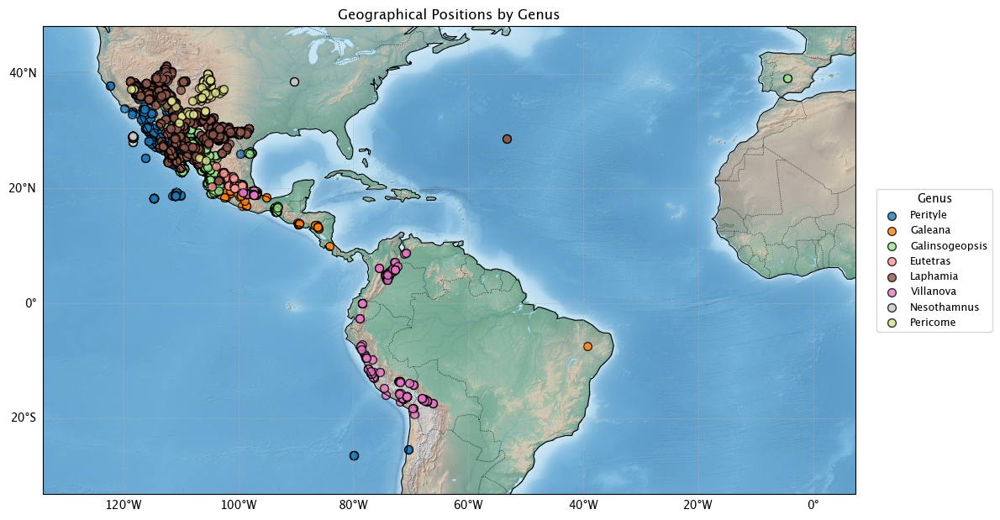

In [26]:
plot_geographical_positions(
    df_full,
    lat_col='decimalLatitude', 
    lon_col='decimalLongitude',
    raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedGenus', group_label='Genus'
)


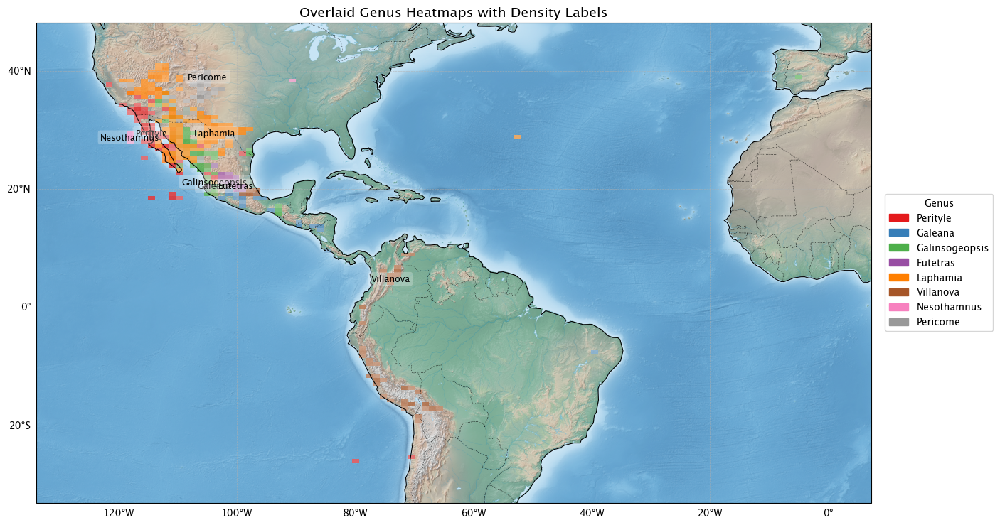

In [27]:
plot_geographical_heatmap_overlay(
    df_full,
    lat_col='decimalLatitude', 
    lon_col='decimalLongitude',
    raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedGenus', group_label='Genus'
)


## b. Perityle

In [28]:
perityle_df = df_full[df_full['acceptedGenus'] == 'Perityle']
print('Number of collected specimens:', len(perityle_df))
print('Species:', perityle_df['acceptedSpecies'].unique())


Number of collected specimens: 1125
Species: ['tenuifolius' 'brandegeeana' 'carterae' 'emoryi' 'aurea' 'cuneata'
 'crassifolia' 'rosei' 'socorrosensis' 'trichodonta']


All of interest (from Nomenclator)
- Perityle aurea Rose
- Perityle brandegeeana Rose
- Perityle californica Benth.
- Perityle carterae (A.M. Powell) I.H. Lichter-Marck
- Perityle crassifolia Brandegee var. crassifolia
- Perityle crassifolia var. robusta (Rydb.) Everly
- Perityle cuneata Brandegee var. cuneata 
- Perityle cuneata var. marginata (Rydb.) I.M. Johnston 
- Perityle emoryi Torr.
- Perityle rosei Greenm.
- Perityle rotundifolia (Benth.) T.S. Brandegee
- Perityle socorrosensis Rose
- Perityle tenuifolius (Phil.) I.H. Lichter-Marck
- Perityle trichodonta S.F. Blake 

### i. All

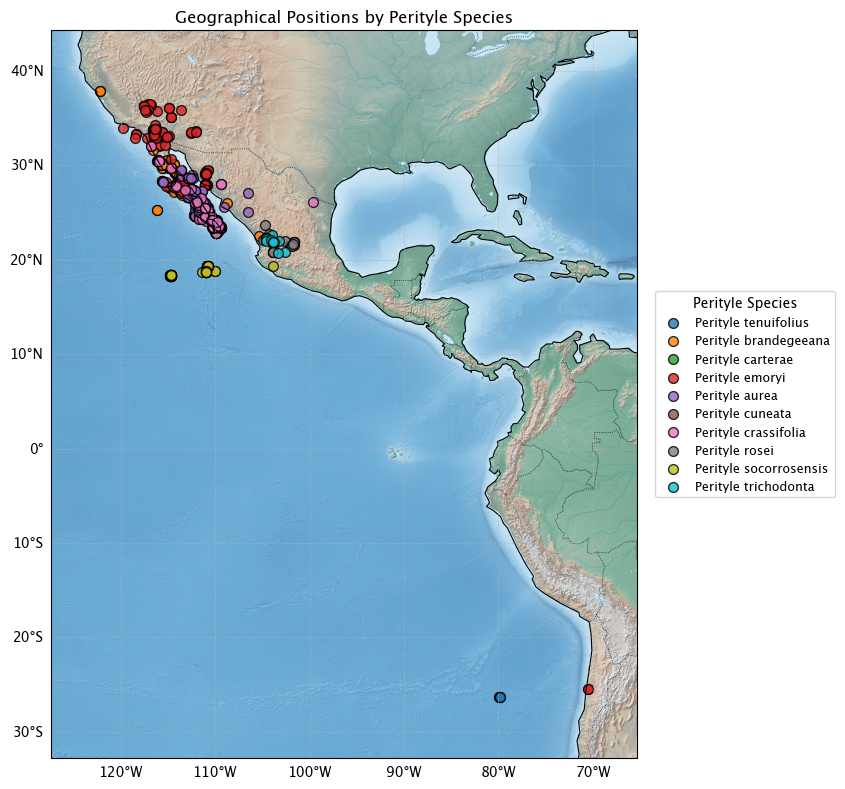

In [29]:
plot_geographical_positions(
    perityle_df,
    lat_col='decimalLatitude', 
    lon_col='decimalLongitude',
    raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Perityle Species'
)


### ii. Baja, CA and SW U.S


In [30]:
perityle_subset_1 = [
'aurea', 
'brandegeeana', 
'californica', 
'carterae', 
'crassifolia', 
'crassifolia', 
'cuneata', 
'cuneata', 
'emoryi',
'rotundifolia', 
'socorrosensis']

perityle_subset_1_df = perityle_df[perityle_df.acceptedSpecies.isin(perityle_subset_1)]

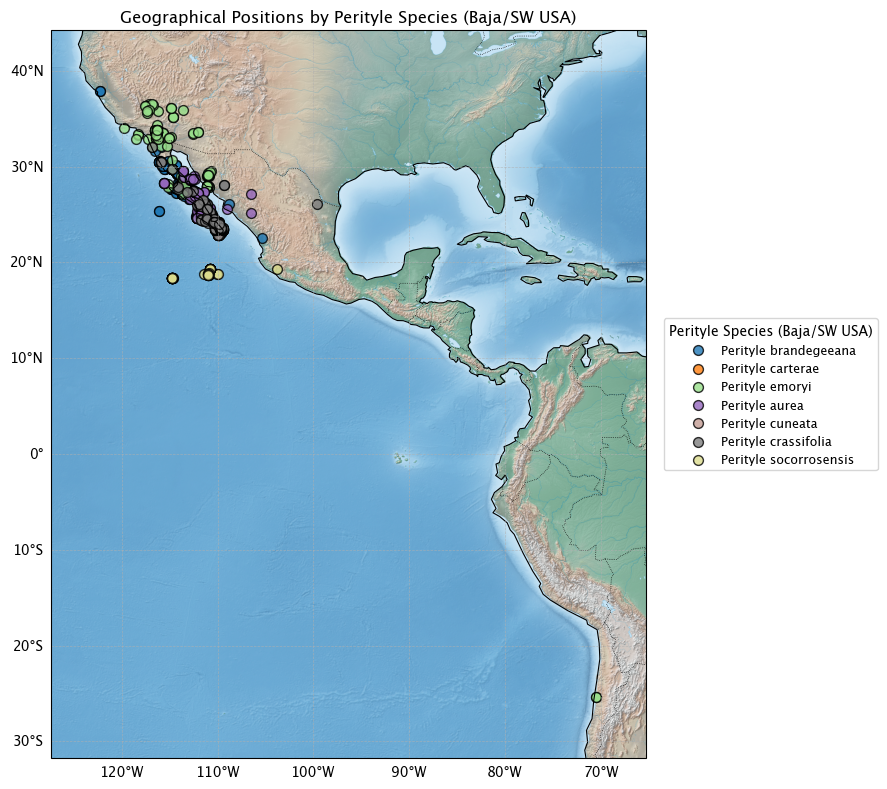

In [31]:
plot_geographical_positions(
    perityle_subset_1_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Perityle Species (Baja/SW USA)'
)


### iii. Chile


In [32]:
perityle_subset_2 = ['tenuifolius', 'emoryi']

perityle_subset_2_df = perityle_df[perityle_df.acceptedSpecies.isin(perityle_subset_2)]

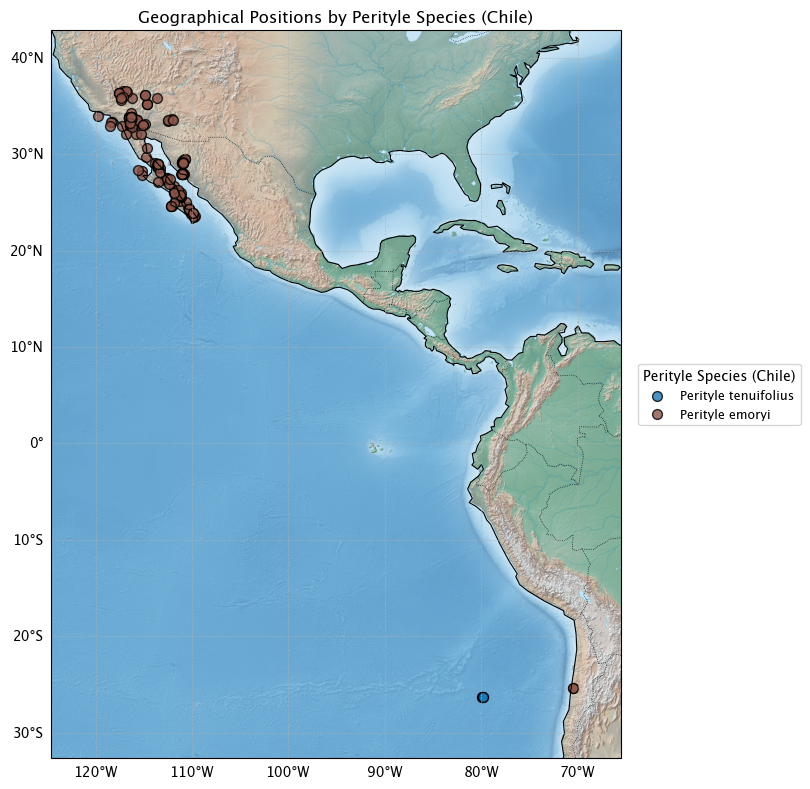

In [33]:
plot_geographical_positions(
    perityle_subset_2_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Perityle Species (Chile)',
)


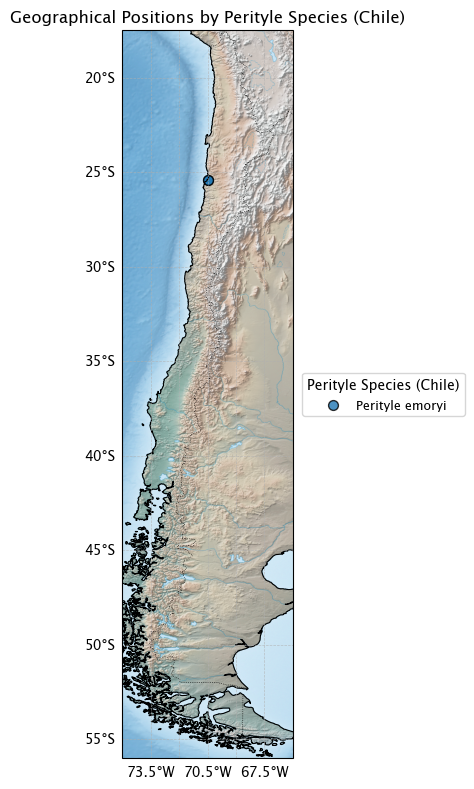

In [34]:
plot_geographical_positions(
    perityle_subset_2_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Perityle Species (Chile)',
    bbox=[-75.0, -66.0, -56.0, -17.5]
)


### iv. Mainland Mexico


In [35]:
perityle_subset_3 = ['rosei', 'trichodonta']

perityle_subset_3_df = perityle_df[perityle_df.acceptedSpecies.isin(perityle_subset_3)]

len(perityle_subset_3_df)

42

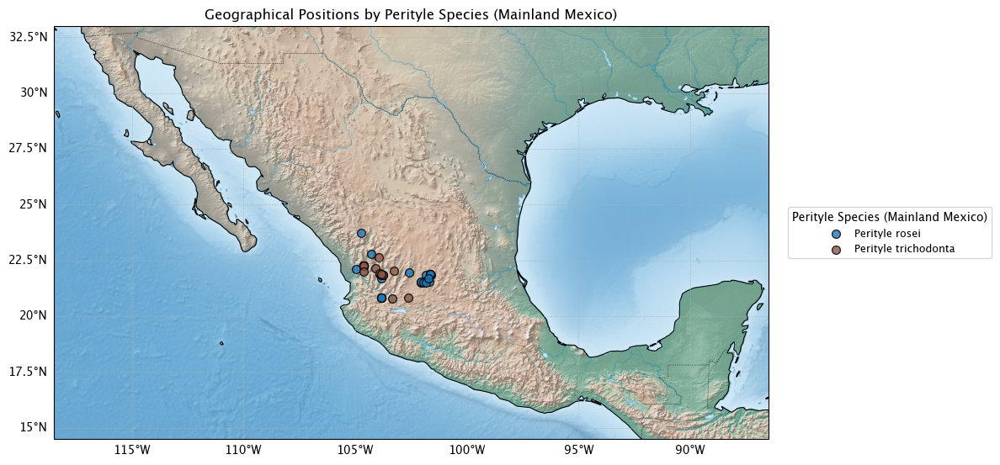

In [36]:
plot_geographical_positions(
    perityle_subset_3_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Perityle Species (Mainland Mexico)',
    bbox = [-118.5, -86.5, 14.5, 33.0]
)


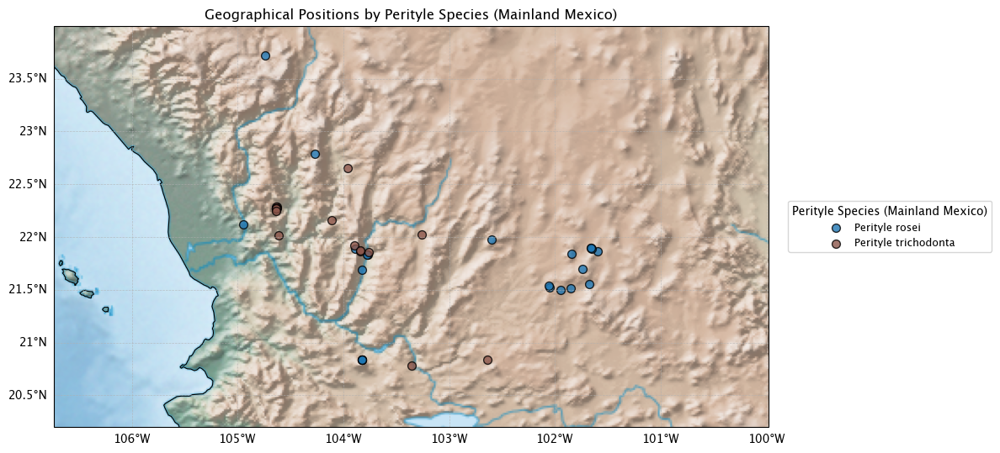

In [37]:
plot_geographical_positions(
    perityle_subset_3_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Perityle Species (Mainland Mexico)',
    bbox = [-106.74,-99.98,20.2,24.0]
)


## c. Pericome

### i. All


In [38]:
pericome_df = df_full[df_full['acceptedGenus'] == 'Pericome']
print('Number of collected specimens:', len(pericome_df))
print('Species:', pericome_df['acceptedSpecies'].unique())


Number of collected specimens: 104
Species: ['caudata' 'macrocephala']


All of interest (from Nomenclator)
- Pericome caudata A. Gray
- Pericome macrocephala B.L. Rob.

In [39]:
pericome_subset_1 = ['caudata', 'macrocephala']

pericome_subset_1_df = pericome_df[pericome_df.acceptedSpecies.isin(pericome_subset_1)]

len(pericome_subset_1_df)

104

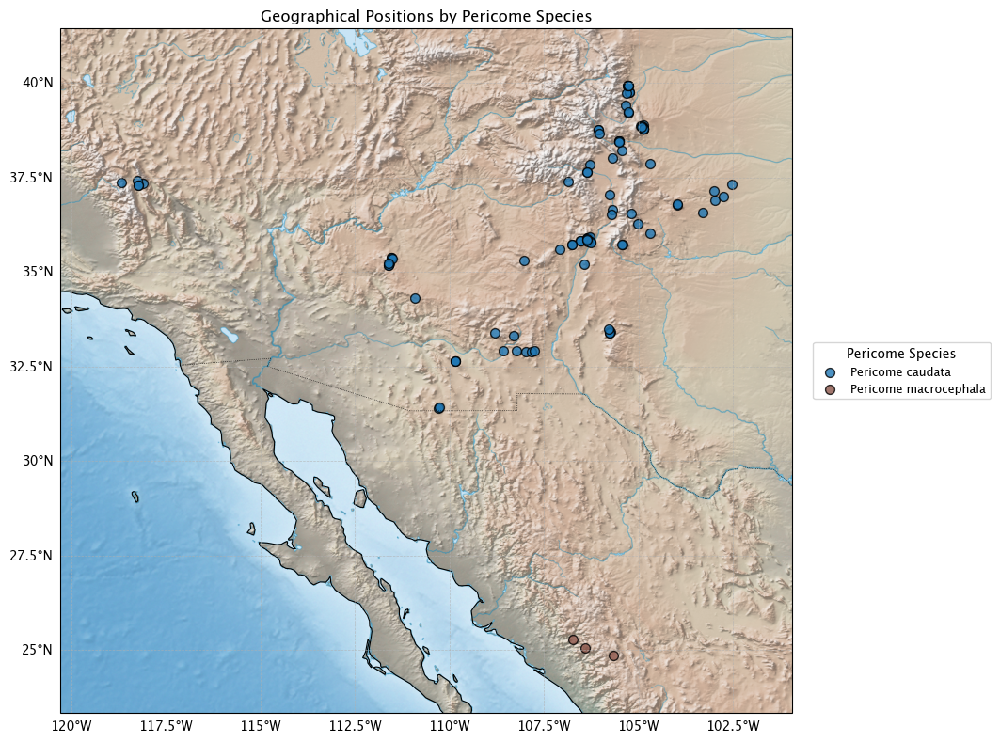

In [40]:
plot_geographical_positions(
    pericome_subset_1_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Pericome Species',
    # bbox = [-118.5, -86.5, 14.5, 33.0]
)


## d. Eutetras

### i. All


In [41]:
eutetras_df = df_full[df_full['acceptedGenus'] == 'Eutetras']
print('Number of collected specimens:', len(eutetras_df))
print('Species:', eutetras_df['acceptedSpecies'].unique())


Number of collected specimens: 157
Species: ['palmeri' 'pringlei']


All of interest (from Nomenclator)
- eutetras palmeri A. Gray
- eutetras pringlei Greenm.,

In [42]:
eutetras_subset_1 = ['palmeri', 'pringlei']

eutetras_subset_1_df = eutetras_df[eutetras_df.acceptedSpecies.isin(eutetras_subset_1)]

len(eutetras_subset_1_df)

157

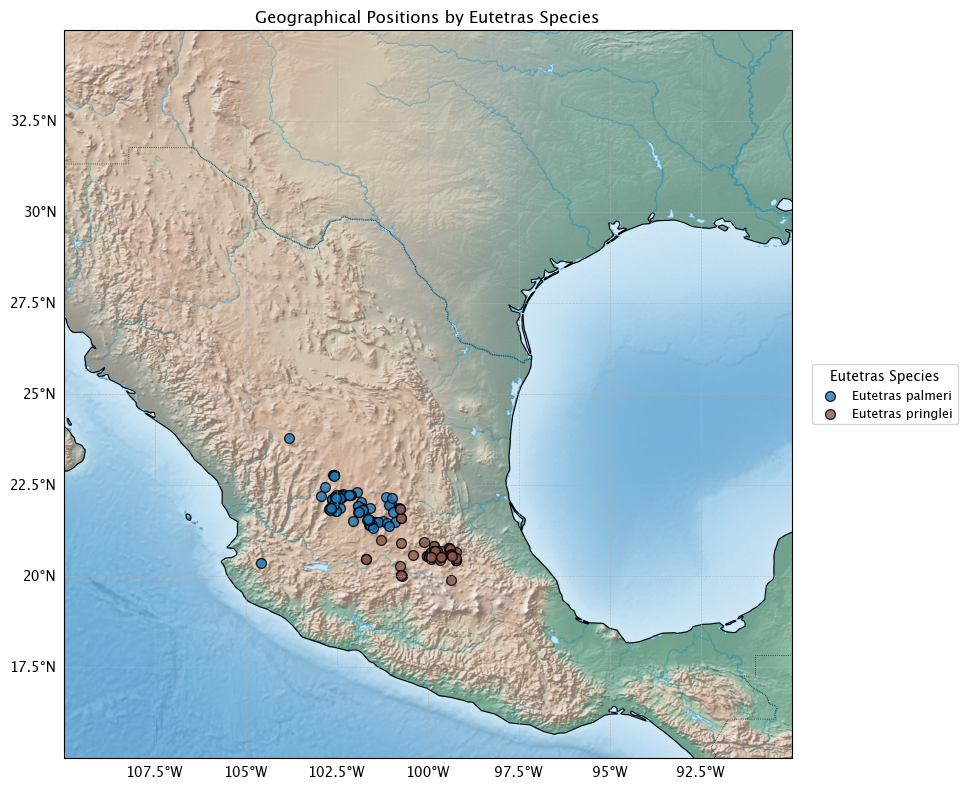

In [43]:
plot_geographical_positions(
    eutetras_subset_1_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Eutetras Species',
    bbox = [-110, -90, 15, 35]
)


## e. Nesothamnus

### i. All


In [44]:
nesothamnus_df = df_full[df_full['acceptedGenus'] == 'Nesothamnus']
print('Number of collected specimens:', len(nesothamnus_df))
print('Species:', nesothamnus_df['acceptedSpecies'].unique())


Number of collected specimens: 162
Species: ['incanus']


All of interest (from Nomenclator)
- Nesothamnus incanus (A. Gray) Rydb

In [45]:
nesothamnus_subset_1 = ['incanus']

nesothamnus_subset_1_df = nesothamnus_df[nesothamnus_df.acceptedSpecies.isin(nesothamnus_subset_1)]

len(nesothamnus_subset_1_df)

162

Guadalupe Island


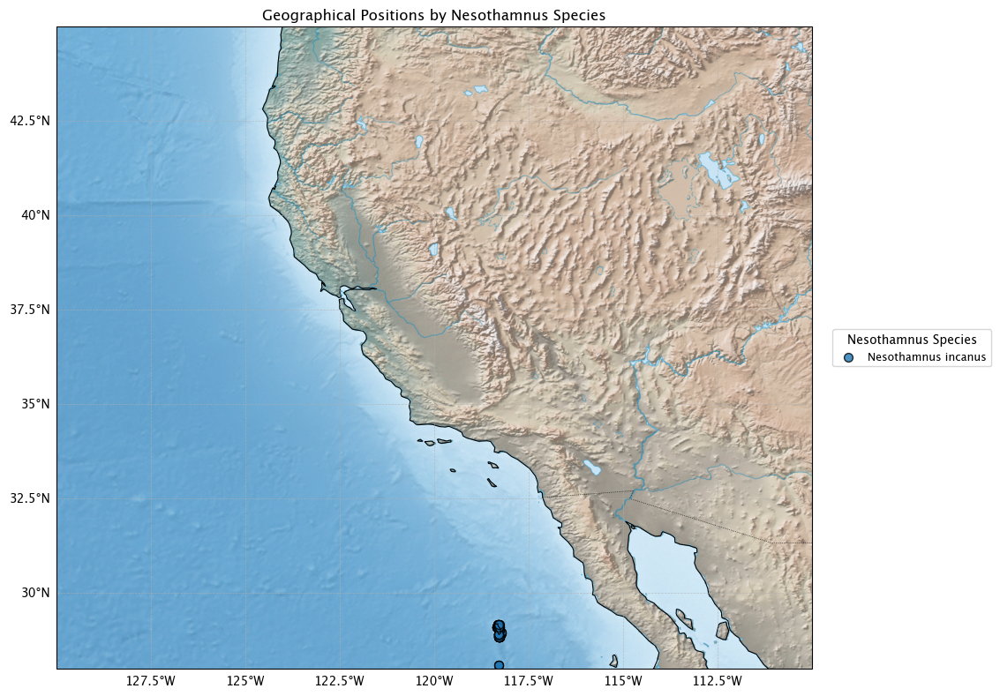

In [46]:
plot_geographical_positions(
    nesothamnus_subset_1_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Nesothamnus Species',
    bbox = [-130, -110, 28, 45]
)


Looks like there's an errant latitude here!

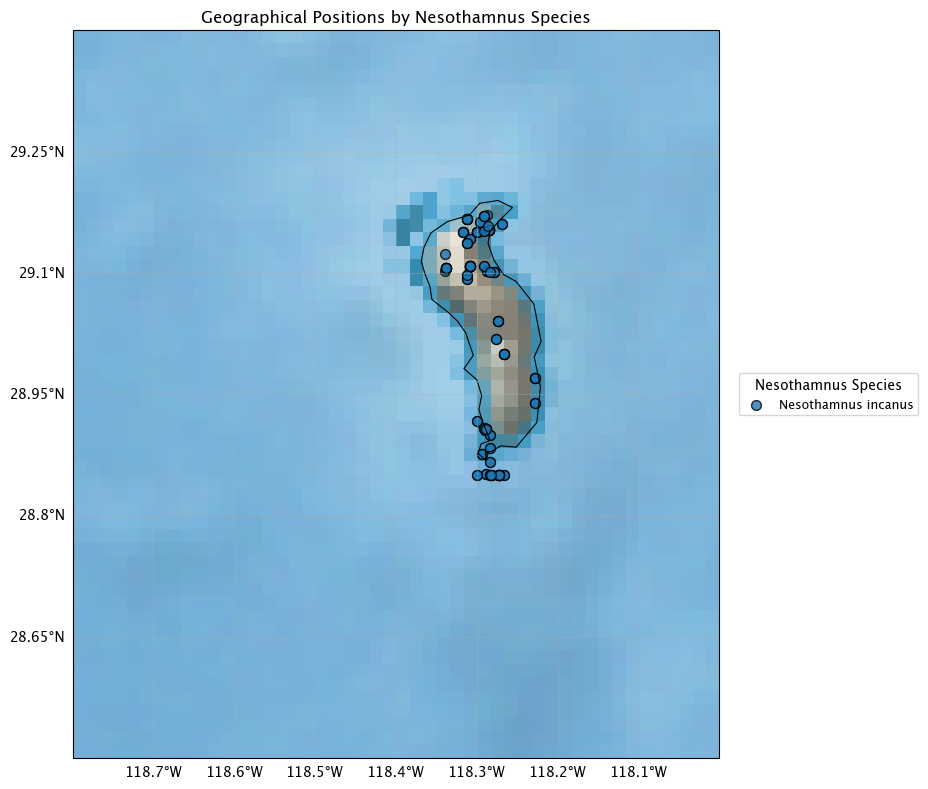

In [47]:
plot_geographical_positions(
    nesothamnus_subset_1_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Nesothamnus Species',
    bbox = [-118.8, -118, 28.5, 29.4]
)


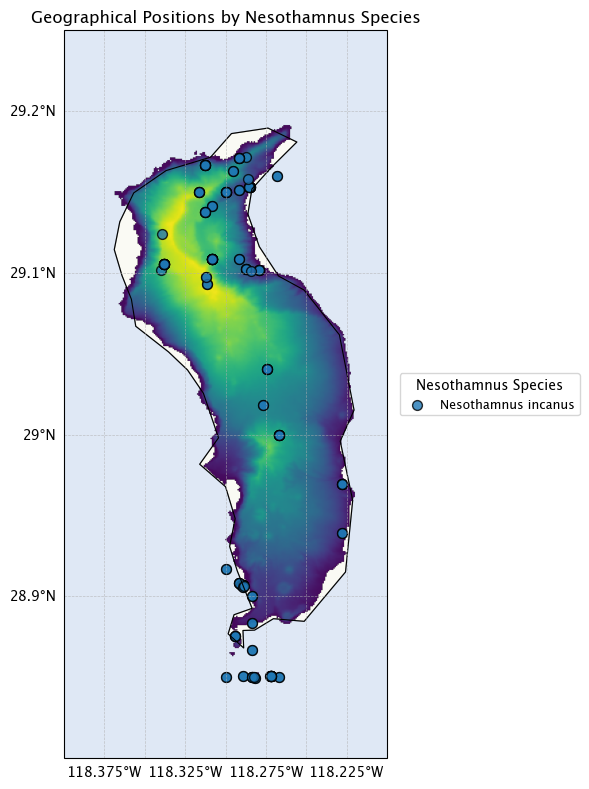

In [48]:
plot_geographical_positions(
    nesothamnus_subset_1_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/guadalupe/output_SRTMGL3.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Nesothamnus Species',
    bbox = [-118.4, -118.2, 28.8, 29.25]
)


In [49]:
nesothamnus_subset_1_df

,key,occurrenceStatus,taxonKey,kingdomKey,phylumKey,classKey,orderKey,familyKey,genusKey,speciesKey,...,fieldNotes,locationRemarks,eventRemarks,organismName,verbatimIdentification,organismQuantity,organismQuantityType,acceptedName,acceptedGenus,acceptedSpecies
7229,3068099650,PRESENT,5693137,6,7707728,220,414,3065,7336287,5693137.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Nesothamnus incanus,Nesothamnus,incanus
7230,2269305576,PRESENT,5693137,6,7707728,220,414,3065,7336287,5693137.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Nesothamnus incanus,Nesothamnus,incanus
7232,1453085170,PRESENT,5693137,6,7707728,220,414,3065,7336287,5693137.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Nesothamnus incanus,Nesothamnus,incanus
7234,3125100994,PRESENT,3146381,6,7707728,220,414,3065,7336287,5693137.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Nesothamnus incanus,Nesothamnus,incanus
7235,3053415405,PRESENT,3146381,6,7707728,220,414,3065,7336287,5693137.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Nesothamnus incanus,Nesothamnus,incanus
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7424,4856833500,PRESENT,3146381,6,7707728,220,414,3065,7336287,5693137.0,...,NaN,28 53 - 29 10 N; 118 17 W.,NaN,NaN,NaN,NaN,NaN,Nesothamnus incanus,Nesothamnus,incanus
7425,1426446795,PRESENT,3146381,6,7707728,220,414,3065,7336287,5693137.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Nesothamnus incanus,Nesothamnus,incanus
7426,2629900424,PRESENT,3146381,6,7707728,220,414,3065,7336287,5693137.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Nesothamnus incanus,Nesothamnus,incanus
7427,2629894407,PRESENT,3146381,6,7707728,220,414,3065,7336287,5693137.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Nesothamnus incanus,Nesothamnus,incanus


In [50]:
plot_3d_relief_with_species(
    tif_path='../data/guadalupe/output_SRTMGL3.tif',
    group_col='acceptedName',
    group_label='Nesothamnus Species',
    lat_col='decimalLatitude',      lon_col='decimalLongitude',         
    bbox = [-118.4, -118.2, 28.8, 29.25], #    bbox=[-119, -111, 35, 42],
    df=nesothamnus_subset_1_df,
    elev_exaggeration=0.00005,
    point_size=25.0,
    lift_above_surface=0.01,
    surface_patch_scale=15.0,
    colormap='gist_earth'
    
)


Widget(value='<iframe src="http://localhost:50803/index.html?ui=P_0x16db1aa50_0&reconnect=auto" class="pyvista…

## f. Galinsogeopsis

### i. All

Number of collected specimens: 1106
Species: ['montana' 'canescens' 'ciliata' 'coronopifolia' 'feddemae' 'glaucescens'
 'harkerae' 'hofmeisteria' 'jaliscana' 'lineariloba' 'microcephala'
 'microglossa' 'pseudociliata' 'scopulorum' 'turneri' 'vigilans']


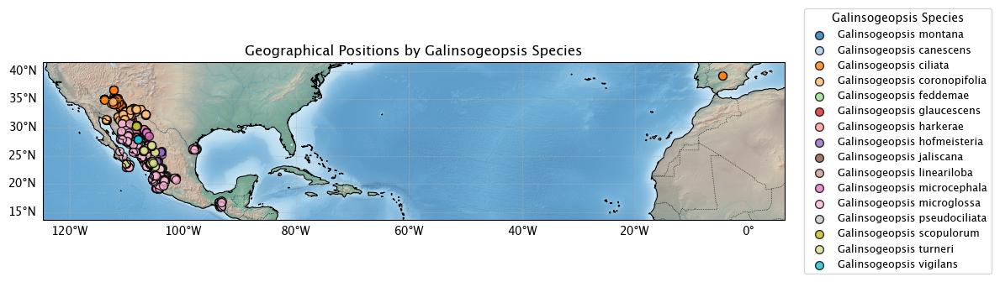

In [51]:
galinsogeopsis_df = df_full[df_full['acceptedGenus'] == 'Galinsogeopsis']
print('Number of collected specimens:', len(galinsogeopsis_df))
print('Species:', galinsogeopsis_df['acceptedSpecies'].unique())

plot_geographical_positions(
    galinsogeopsis_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName',
    group_label='Galinsogeopsis Species'
)


### ii. Widespread

No data inside bounding box. Nothing to plot.


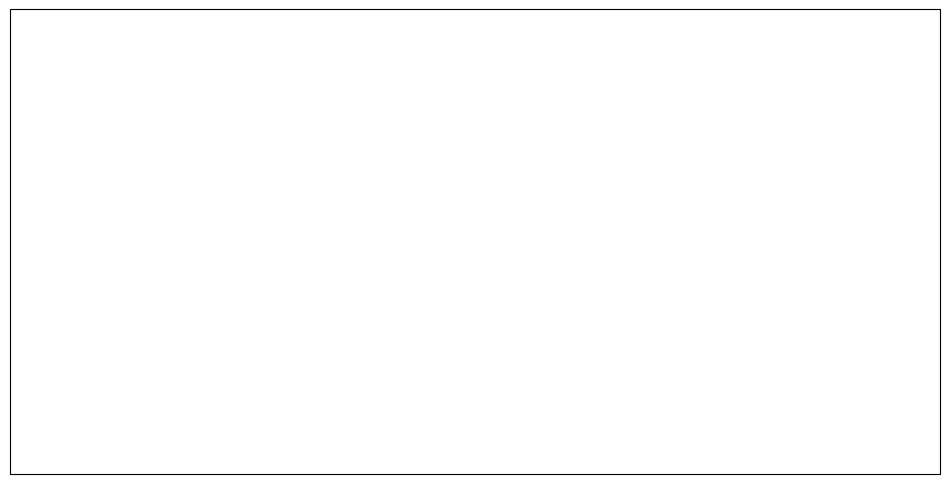

In [52]:
# gali_subset_1 = ['microglossa', 'microglossa']  # covers both varieties
gali_subset_1 = ['spilanthoides'] # microglossa won't show anything bc new name, use spilanthoides instead
gali_subset_1_df = galinsogeopsis_df[galinsogeopsis_df['acceptedSpecies'].isin(gali_subset_1)]

plot_geographical_positions(
    gali_subset_1_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName',
    group_label='Galinsogeopsis Species (Widespread)'
)


### iii. Isolated

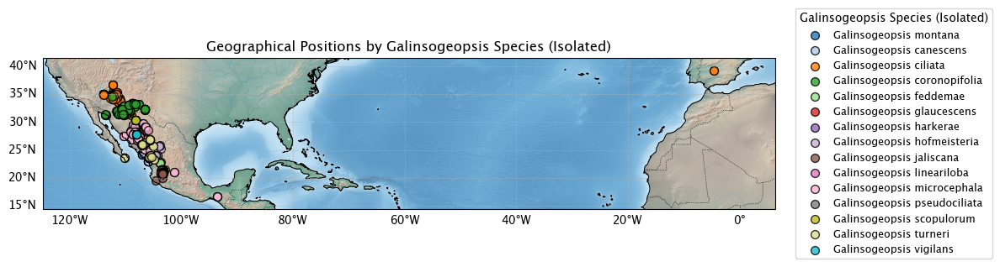

In [53]:
gali_subset_2 = [
    'canescens', 'ciliata', 'coronopifolia', 'feddemae', 'glaucescens', 'harkerae', 'hofmeisteria',
    'jaliscana', 'lineariloba', 'microcephala', 'montana', 'pseudociliata', 'scopulorum',
    'turneri', 'vigilans'
]
gali_subset_2_df = galinsogeopsis_df[galinsogeopsis_df['acceptedSpecies'].isin(gali_subset_2)]

plot_geographical_positions(
    gali_subset_2_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName',
    group_label='Galinsogeopsis Species (Isolated)'
)


## g. Laphamia

### i. All

Number of collected specimens: 3044
Species: ['aglossa' 'ajoensis' 'ambrosiifolia' 'angustifolia' 'gilensis'
 'batopilensis' 'bisetosa' 'carmenensis' 'castillonii' 'cernua' 'cinerea'
 'coahuilensis' 'cochisensis' 'toumeyi' 'cordifolia' 'dissecta' 'gracilis'
 'fosteri' 'gentryi' 'grandifolia' 'huecoensis' 'intricata'
 'megalocephala' 'inyoensis' 'lemmonii' 'leptoglossa' 'lindheimeri'
 'lloydii' 'lobata' 'sanchezii' 'parryi' 'quinqueflora' 'reinana'
 'rupestris' 'specuicola' 'stansburyi' 'staurophylla' 'vandevenderi'
 'vaseyi' 'villosa' 'vitreomontana' 'warnockii']


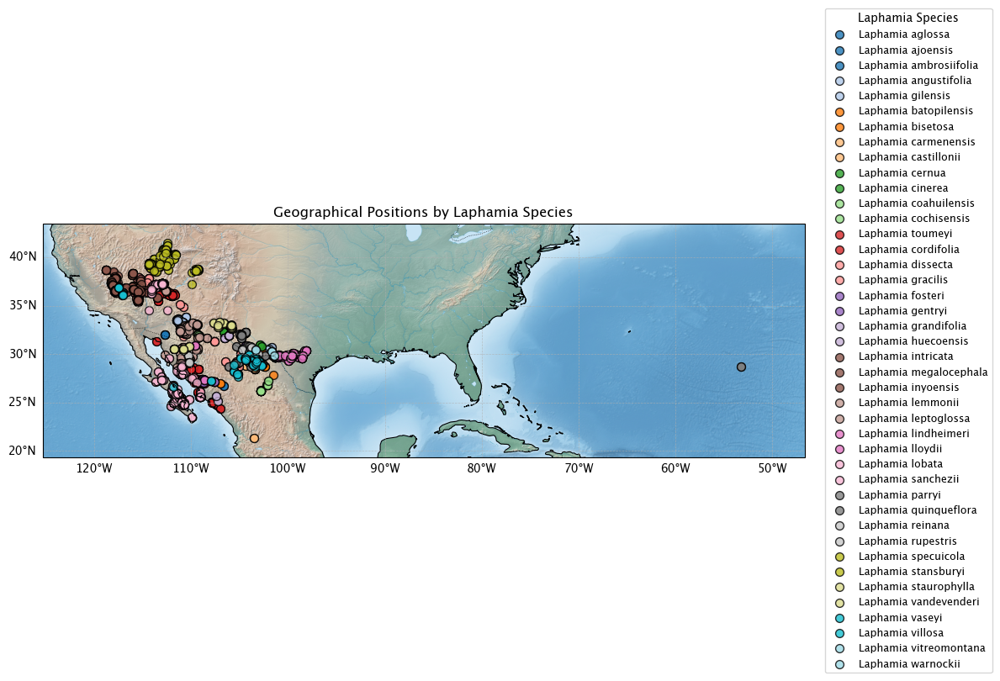

In [54]:
laphamia_df = df_full[df_full['acceptedGenus'] == 'Laphamia']
print('Number of collected specimens:', len(laphamia_df))
print('Species:', laphamia_df['acceptedSpecies'].unique())

plot_geographical_positions(
    laphamia_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    group_col='acceptedName',
    group_label='Laphamia Species'
)


### ii. Sonora/Sinaloa + Baja California

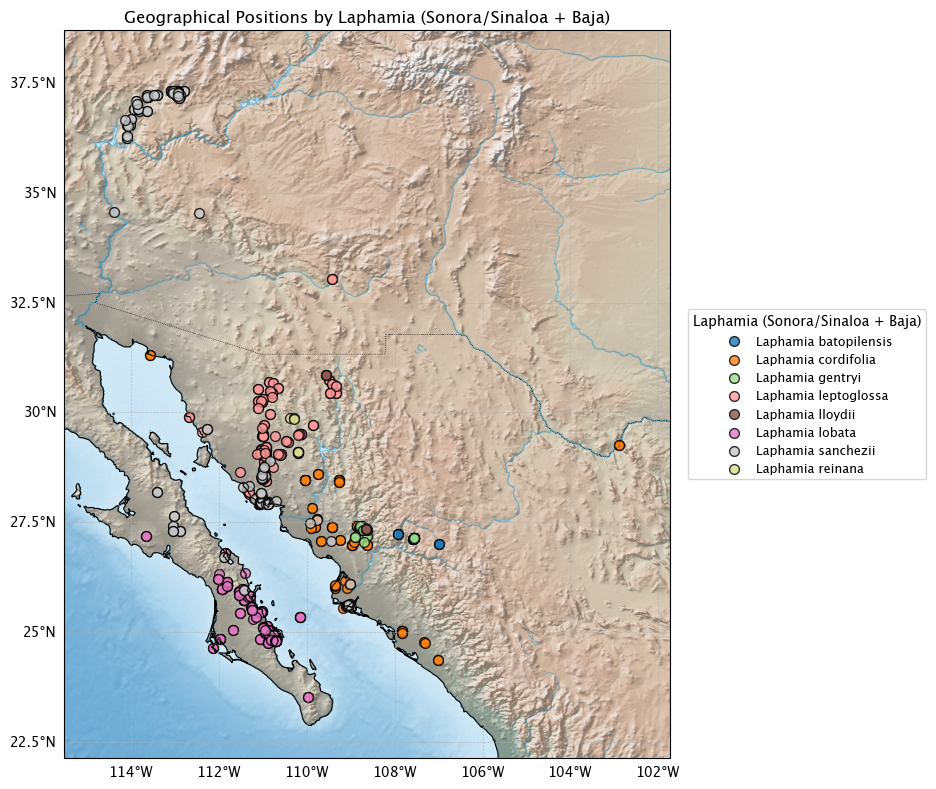

In [55]:
laphamia_subset_1 = ['reinana', 'leptoglossa', 'cordifolia', 'sanchezii', 'lobata', 'gentryi', 'batopilensis', 'lloydii']
laphamia_subset_1_df = laphamia_df[laphamia_df['acceptedSpecies'].isin(laphamia_subset_1)]

plot_geographical_positions(
    laphamia_subset_1_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    group_col='acceptedName',
    group_label='Laphamia (Sonora/Sinaloa + Baja)'
)


### iii. Big Bend Region

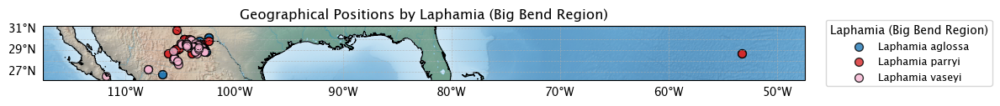

In [56]:
laphamia_subset_2 = ['parryi', 'vaseyi', 'aglossa']
laphamia_subset_2_df = laphamia_df[laphamia_df['acceptedSpecies'].isin(laphamia_subset_2)]

plot_geographical_positions(
    laphamia_subset_2_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    group_col='acceptedName',
    group_label='Laphamia (Big Bend Region)'
)


### iv. Western Texas Sky Islands

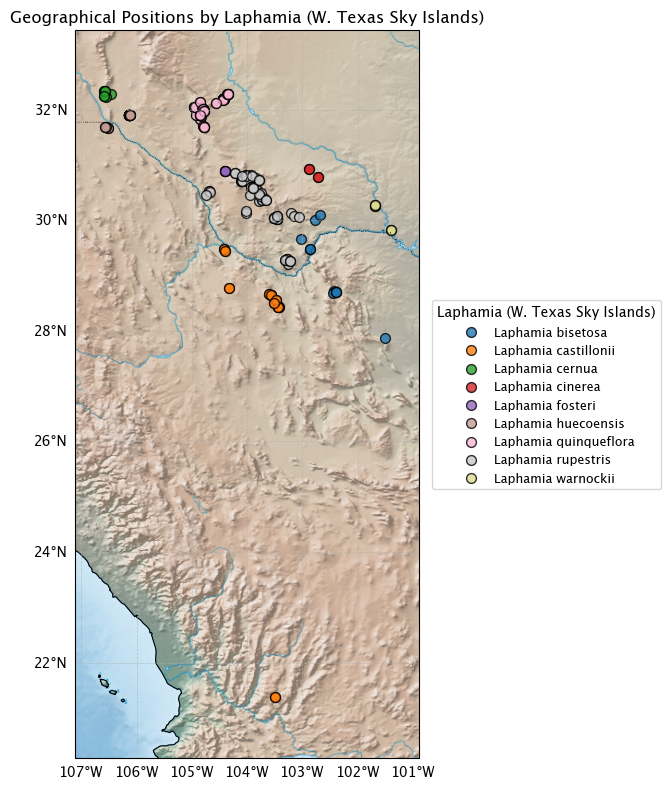

In [57]:
laphamia_subset_3 = ['rupestris', 'cinerea', 'fosteri', 'quinqueflora', 'castillonii',
                     'bisetosa', 'cernua', 'huecoensis', 'warnockii']
laphamia_subset_3_df = laphamia_df[laphamia_df['acceptedSpecies'].isin(laphamia_subset_3)]

plot_geographical_positions(
    laphamia_subset_3_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    group_col='acceptedName',
    group_label='Laphamia (W. Texas Sky Islands)'
)


### v. AZ/New Mexico Sky Islands

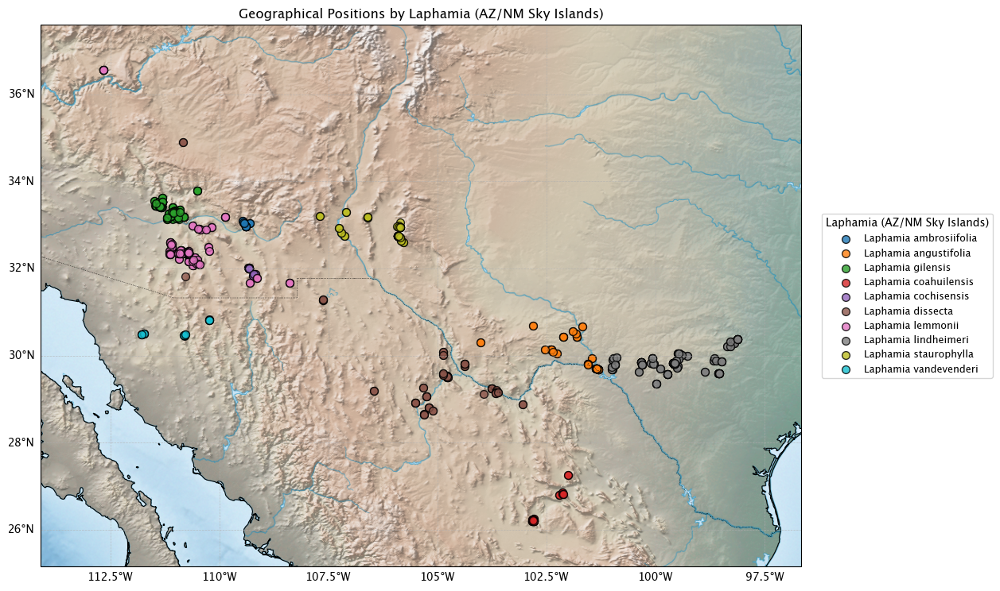

In [58]:
laphamia_subset_4 = [
    'dissecta', 'cochisensis', 'angustifolia', 'lindheimeri', 'staurophylla', 'vandevenderi',
    'lemmonii', 'ambrosiifolia', 'gilensis', 'coahuilensis', 'saxicola'
]
laphamia_subset_4_df = laphamia_df[laphamia_df['acceptedSpecies'].isin(laphamia_subset_4)]

plot_geographical_positions(
    laphamia_subset_4_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    group_col='acceptedName',
    group_label='Laphamia (AZ/NM Sky Islands)'
)


### vi. Great Basin Clade

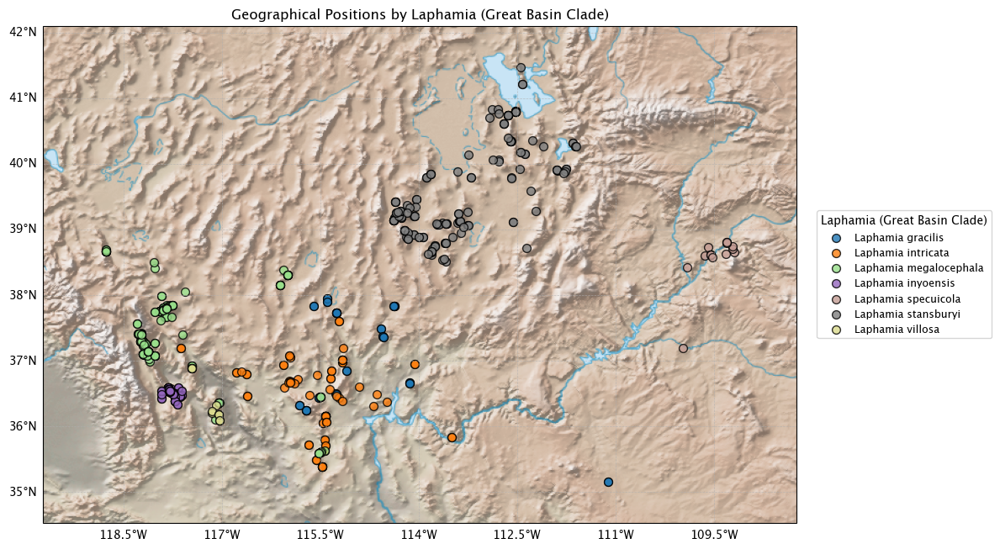

In [59]:
laphamia_subset_5 = [
    'congesta', 'stansburyi', 'tenella', 'specuicola', 'gracilis', 'intricata',
    'megalocephala', 'villosa', 'inyoensis'
]
laphamia_subset_5_df = laphamia_df[laphamia_df['acceptedSpecies'].isin(laphamia_subset_5)]

plot_geographical_positions(
    laphamia_subset_5_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    group_col='acceptedName',
    group_label='Laphamia (Great Basin Clade)'
)


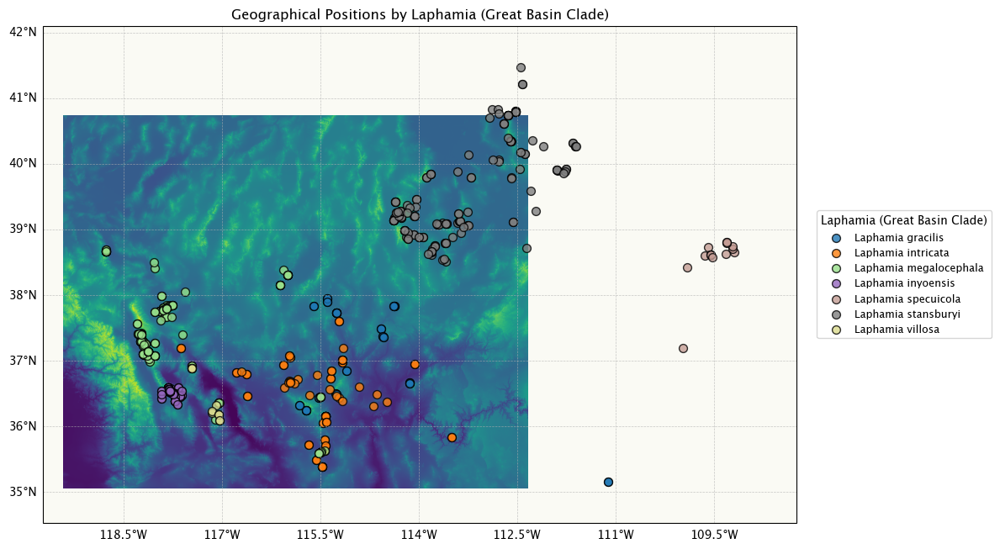

In [60]:
plot_geographical_positions(
    laphamia_subset_5_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/great_basin/output_be.tif',
    group_col='acceptedName',
    group_label='Laphamia (Great Basin Clade)'
)

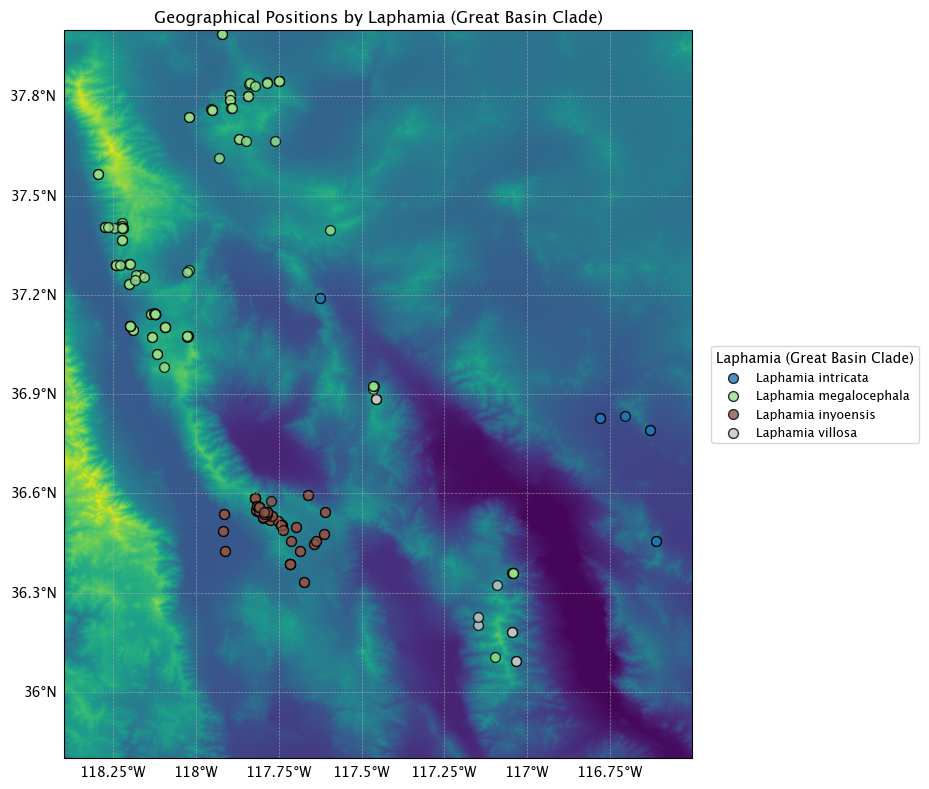

In [61]:
plot_geographical_positions(
    laphamia_subset_5_df,
    bbox=[-118.4, -116.5, 35.8, 38],
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/great_basin/output_be.tif',
    group_col='acceptedName',
    group_label='Laphamia (Great Basin Clade)'
)

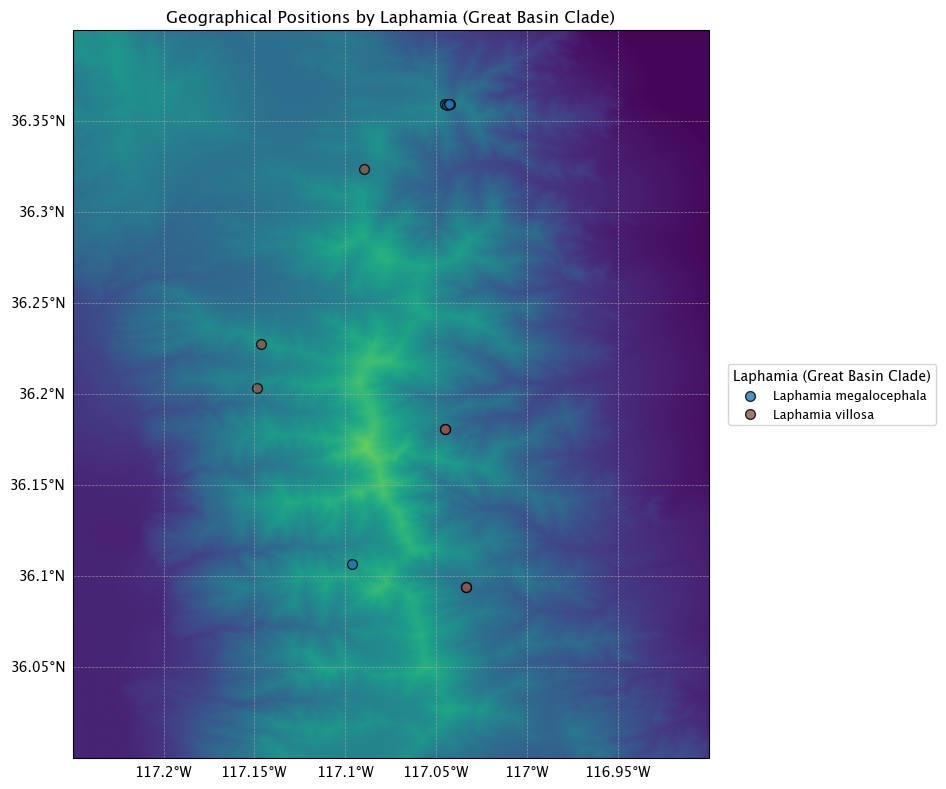

In [62]:
plot_geographical_positions(
    laphamia_subset_5_df,
    bbox=[-117.25, -116.9, 36, 36.4],
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/great_basin/output_be.tif',
    group_col='acceptedName',
    group_label='Laphamia (Great Basin Clade)'
)

In [65]:
plot_3d_relief_with_species(
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     tif_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    bbox=[-119, -111, 35, 42],
    df=laphamia_subset_5_df,
    elev_exaggeration=0.0008,
    point_size=15.0,
    lift_above_surface=0.05,
    surface_patch_scale=5.0,
    colormap='gist_earth',
    group_col='acceptedName',
    group_label='Great Basin Laphamia Species',
    
)


Widget(value='<iframe src="http://localhost:50803/index.html?ui=P_0x2c3d35810_2&reconnect=auto" class="pyvista…

In [64]:
plot_3d_relief_with_species(
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     tif_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    bbox=[-118.4, -116.5, 35.8, 38],
    df=laphamia_subset_5_df,
    elev_exaggeration=0.0004,
    point_size=15.0,
    lift_above_surface=0.05,
    surface_patch_scale=5.0,
    colormap='gist_earth',
    group_col='acceptedName',
    group_label='Great Basin Laphamia Species',
    
)

Widget(value='<iframe src="http://localhost:50803/index.html?ui=P_0x29bb65310_1&reconnect=auto" class="pyvista…